# Predictions

In [ ]:
%pip install pandas numpy
%pip install tensorflow[and-cuda]
%pip install scikit-learn
%pip install matplotlib

In [1]:
from IPython.display import HTML

import os 
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation


In [2]:
# Constants
parties_du_corps=["Bassin","HancheD","GenouD","ChevilleD","HancheG","GenouG","ChevilleG","Colonne","Thorax","Cou","Tete","EpauleG","CoudeG","PoignetG","EpauleD","CoudeD","PoignetD"]
path="./data/points"
SQUELETTE = [
    (0,1),(1,2),(2,3),        # jambe droite
    (0,4),(4,5),(5,6),        # jambe gauche
    (0,7),(7,8),(8,9),(9,10), # colonne
    (8,11),(11,12),(12,13),   # bras gauche
    (8,14),(14,15),(15,16)   # bras droit
]


In [3]:
#import des points
points = os.listdir(path)
points = [f for f in points if os.path.isfile(os.path.join(path, f))]
datas=[]
for ele in points:
    df=pd.DataFrame(pd.read_json(os.path.join(path, ele))['instances'].str[0].str.get('keypoints').to_list())
    df.columns=parties_du_corps
    datas.append(df)

## formatage des données
Nous considérerons un jeu de données séquentielle par vidéo.
Chaque vecteur d'entrées du modèle fera 17x3 en dimension, soit les coordonées des 17 membres enregistré.


`in` : $\mathbb{R}^{17} \times \mathbb{R}^{3}$

On ressors une prédiction du même type

`out` : $\mathbb{R}^{17} \times \mathbb{R}^{3}$

In [4]:
# formatage des données :
fdatas = [
    np.array([
        np.array([np.array(df[dt][i]) for dt in df]) 
        for i in range(df.shape[0])
    ])
    for df in datas
]
del datas



In [5]:
PointSequence = type(fdatas[0])

## Fonctions utilitaires

In [6]:
def compute_velocity(sequence: PointSequence) -> PointSequence:
    vel = []
    for i in range(len(sequence)):
        t_0 = sequence[i - 1] if i > 0 else np.array(0)
        t_1 = sequence[i]
        vel.append(t_1 - t_0)
    return np.array(vel)


def plot_animation(sequence, title=""):
    T, _, _ = sequence.shape

    fig = plt.figure()
    ax = fig.add_subplot(111, projection="3d")
    ax.set_title(title)

    # limites fixes
    mins = sequence.min(axis=(0,1))
    maxs = sequence.max(axis=(0,1))

    ax.set_xlim(mins[0], maxs[0])
    ax.set_ylim(mins[1], maxs[1])
    ax.set_zlim(mins[2], maxs[2])

    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")

    pts0 = sequence[0]

    points = ax.scatter(
        pts0[:,0], pts0[:,1], pts0[:,2],
        c="red", s=40
    )

    lines = []
    for i, j in SQUELETTE:
        line, = ax.plot(
            [pts0[i,0], pts0[j,0]],
            [pts0[i,1], pts0[j,1]],
            [pts0[i,2], pts0[j,2]],
            c="black"
        )
        lines.append(line)

    def update(frame):
        pts = sequence[frame]

        points._offsets3d = (pts[:,0], pts[:,1], pts[:,2])

        for line, (i, j) in zip(lines, SQUELETTE):
            line.set_data([pts[i,0], pts[j,0]],
                          [pts[i,1], pts[j,1]])
            line.set_3d_properties([pts[i,2], pts[j,2]])

        return [points] + lines

    return FuncAnimation(
        fig,
        update,
        frames=T,
        interval=33,
        blit=False
    )

## Premier Jet

Nous allons tenté d'utiliser un [LSTM](https://en.wikipedia.org/wiki/Long_short-term_memory)

In [7]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Input

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error


2026-01-18 10:48:29.457568: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [8]:
WINDOW_SIZE = 30

LSTM1 = Sequential([
    Input((WINDOW_SIZE,51)),
    LSTM(128, return_sequences=True),
    LSTM(128),
    Dense(51)
])

LSTM1.compile(optimizer='adam', loss='mse')

I0000 00:00:1768729711.920950   45261 gpu_device.cc:2020] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 9497 MB memory:  -> device: 0, name: NVIDIA GeForce RTX 4070, pci bus id: 0000:01:00.0, compute capability: 8.9
I0000 00:00:1768729711.922070   45261 gpu_device.cc:2020] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 2604 MB memory:  -> device: 1, name: NVIDIA GeForce GTX 1650, pci bus id: 0000:04:00.0, compute capability: 7.5


Nous faison rentrer dans notre modèle les 30 dernières positions connue, pour qu'il prédise la suivante

In [9]:

def make_data_for_lstm1(data: list[PointSequence], window=WINDOW_SIZE):
    # passage sous forme de "fenêtre"
    def create_sequence(seq: PointSequence):
        x, y = [], []
        for i in range(len(seq) - window):
            x.append(seq[i : i + window])
            y.append(seq[i + window])
        return np.array(x), np.array(y)

    X_all, Y_all = [], []

    for seq in data:
        X, Y = create_sequence(seq)
        X_all.append(X)
        Y_all.append(Y)

    X_all = np.concatenate(X_all)
    Y_all = np.concatenate(Y_all)

    # reshape (17,3) -> 51
    X_all = X_all.reshape(X_all.shape[0], X_all.shape[1], -1)
    Y_all = Y_all.reshape(Y_all.shape[0], -1)
    # normalization
    EPSILON = 1e-8
    mean = X_all.mean(axis=(0, 1))
    std = X_all.std(axis=(0, 1)) + EPSILON

    X_all = (X_all - mean) / std
    Y_all = (Y_all - mean) / std

    return X_all, Y_all, mean, std


def inverse_lstm_output(pred_seq, mean, std):
    pred_seq = np.array(pred_seq)

    # 2D
    if pred_seq.ndim == 3 and pred_seq.shape[1:] == (17,3):
        T = pred_seq.shape[0]
        pred_seq = pred_seq.reshape(T, 51)
    
    # reshape mean et std
    mean_flat = mean.reshape(1, 51)
    std_flat = std.reshape(1, 51)

    # dénormalisation
    pred_seq = pred_seq * std_flat + mean_flat

    # -> (T,17,3)
    pred_seq = pred_seq.reshape(pred_seq.shape[0], 17, 3)

    return pred_seq


In [11]:
# entrainement du modèle
train, test= train_test_split(fdatas[:150])

X, Y, _, _ = make_data_for_lstm1(train)

LSTM1.fit(X, Y, epochs=120, batch_size=64, validation_split=0.2)

2026-01-18 10:49:28.806515: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:84] Allocation of 452335320 exceeds 10% of free system memory.
2026-01-18 10:49:29.293145: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:84] Allocation of 452335320 exceeds 10% of free system memory.


Epoch 1/120
1155/1155 ━━━━━━━━━━━━━━━━━━━━ 7s 6ms/step - loss: 0.0327 - val_loss: 0.0402
Epoch 2/120
1155/1155 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step - loss: 0.0295 - val_loss: 0.0401
Epoch 3/120
1155/1155 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.0284 - val_loss: 0.0395
Epoch 4/120
1155/1155 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.0271 - val_loss: 0.0387
Epoch 5/120
1155/1155 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.0260 - val_loss: 0.0425
Epoch 6/120
1155/1155 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.0252 - val_loss: 0.0398
Epoch 7/120
1155/1155 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.0244 - val_loss: 0.0398
Epoch 8/120
1155/1155 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.0237 - val_loss: 0.0421
Epoch 9/120
1155/1155 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.0233 - val_loss: 0.0394
Epoch 10/120
1155/1155 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.0225 - val_loss: 0.0396
Epoch 11/120
1155/1155 ━━━━━━━━━━━━━━━━━━━━ 6s 5ms/step - loss: 0.0221 - val_loss: 0.0402
Epoch 12/120
1155/1

In [12]:
#test
X_t, Y_t, mean_t, std_t = make_data_for_lstm1(test)
mean_mse = 0
Y_pred = LSTM1.predict(X_t)
for (y_t, y_p) in zip(Y_t, Y_pred):
    mean_mse += mean_squared_error(y_t, y_p)
mean_mse /= len(Y_pred)

print(f"mean mse : {mean_mse}")


  41/1131 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step   

2026-01-18 11:01:12.308398: W external/local_xla/xla/tsl/framework/cpu_allocator_impl.cc:84] Allocation of 221384880 exceeds 10% of free system memory.


1131/1131 ━━━━━━━━━━━━━━━━━━━━ 2s 1ms/step
mean mse : 0.03417210214498254


Comparaison des prédictions avec les vraies valeurs

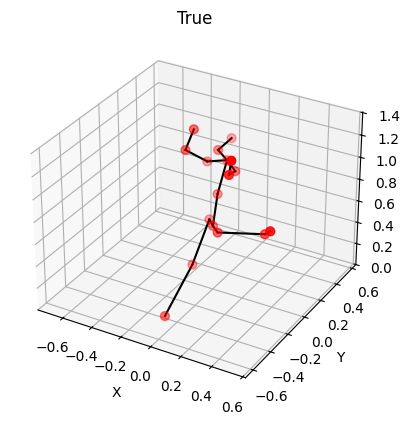

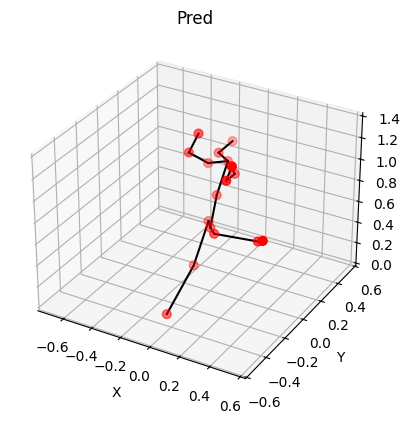

In [13]:

anim1 = plot_animation(test[0][30:150], title="True")
anim2 = plot_animation(inverse_lstm_output(Y_pred, mean_t, std_t)[0:120], title="Pred")


In [14]:
HTML(anim1.to_jshtml()+anim2.to_jshtml())

passage en auto régression  
le modèle s'appuie sur ses dernières valeurs prédit pour en prédire de nouvelles

In [15]:

def auto_pred(model, input, nbframe):
    window = input.copy()
    pred = []

    for _ in range(nbframe):
        y = model.predict(window[None], verbose=0)

        pred.append(y)

        window = np.vstack([window[1:], y])
    
    return np.array(pred)


In [16]:
input = Y_t[0:WINDOW_SIZE]
Y_pred = auto_pred(LSTM1, input, 120)


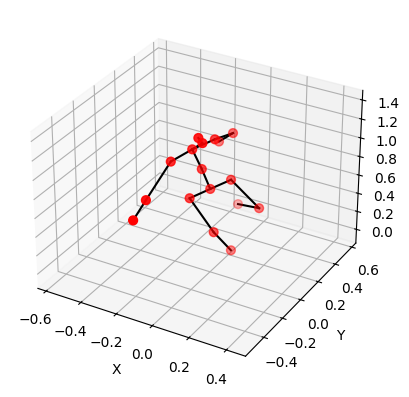

In [17]:
Y_pred_seq = inverse_lstm_output(Y_pred, mean_t, std_t)
anim = plot_animation(Y_pred_seq)
HTML(anim.to_jshtml())

Le résultat n'est pas très bon